# Homework 2 (100 Points)

The goal of this homework is to get more practice with pandas and get practice with clustering on various datasets.



## Exercise 1 - (50 points)

This exercise will be using the [Airbnb dataset](http://insideairbnb.com/get-the-data.html) for NYC called `listings.csv`. You can download it directly [here](http://data.insideairbnb.com/united-states/ny/new-york-city/2021-11-02/visualisations/listings.csv)

a) Produce a Heatmap using the Folium package (you can install it using pip) of the mean listing price per location (lattitude and longitude) over the NYC map. (5 points)

Hints:
1. generate a base map of NYC to plot over: default_location=[40.693943, -73.985880] 
2. generate an HTML file named `index.html` - open it in your browser and you'll see the heatmap 



In [27]:
import folium
from folium.plugins import HeatMap
import pandas as pd
from collections import defaultdict

In [28]:
def display(dataframe: pd.DataFrame, weight='price'):
    prices = defaultdict(list)
    
    for row in dataframe.iterrows():
        prices[
            (row[1]['latitude'], row[1]['longitude'])
        ].append(row[1][weight])

    temp_map = folium.Map(
        location=[40.693943, -73.985880],
        zoom_start=10,
    )

    heat_data = [[key[0], key[1], sum(val) / len(val)]
             for key, val in prices.items()]

    HeatMap(heat_data).add_to(temp_map)

    return temp_map


In [29]:
df = pd.read_csv('listings.csv', dtype=object)
df['price'] = df['price'].astype(int)

m = display(df)

m.save('index.html')

m

b) Normalize the price by subtracting the mean and dividing by the standard deviation. Then reproduce the heatmap from a). Comment on any differences you observe. - (5 points )



In [30]:
temp = df.copy(deep=True)
# temp['price'] = (temp['price'] - temp['price'].mean()) / temp['price'].std()
temp['price'] = temp['price'].subtract(
    temp['price'].mean(), fill_value=0).divide(temp['price'].std(), fill_value=0)

m = display(temp)

m


-> The heatmap seems to be more even, due to the normalisation of the prices. So the more expensive prices do not shade the less expensive ones.

c) Normalize the original price using sklearn's [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) to the interval [0,1]. Then reproduce the Heatmap from a). Comment on any differences you observe.  - (5 points)



In [31]:
from sklearn.preprocessing import MinMaxScaler

min_max_scaler = MinMaxScaler()
temp = df.copy(deep=True)

temp[['price']] = min_max_scaler.fit_transform(temp[['price']])

m = display(temp)

m

-> It seems to be similar to the heatmap produced in a), since we are squashing all of the values to fit between 0 and 1 but still keeping the original spread of the data.

d) Plot a bar chart of the average price (un-normalized) per room type. Briefly comment on the relation between price and room type. - (2.5 points)


<BarContainer object of 4 artists>

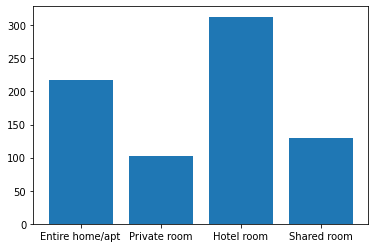

In [32]:
import matplotlib.pyplot as plt
mean_price_per_room_type = defaultdict(list)

for row in df.iterrows():
    mean_price_per_room_type[row[1]['room_type']].append(row[1]['price'])

for key, val in mean_price_per_room_type.items():
    mean_price_per_room_type[key] = sum(val) / len(val)

plt.bar(mean_price_per_room_type.keys(), mean_price_per_room_type.values())

-> The hotel rooms seems to be the most expensive ones, then followed by the whole house/flat. Counterintuitively, the private rooms are cheaper than shared rooms.

e) Plot on the NYC map the top 10 most expensive listings - (2.5 points)

In [33]:
temp: pd.DataFrame = df.copy(deep=True)
temp = temp.sort_values(by=['price'], ascending=False).drop_duplicates(
    subset=['latitude', 'longitude'])


temp = temp[:][:10]

m = display(temp)

m

f) Plot on the NYC map the top 10 most reviewed listings - (2.5 points)


In [34]:
df['number_of_reviews'] = df['number_of_reviews'].astype(int)
temp = df.copy(deep=True)
temp = temp.sort_values(by=['number_of_reviews'], ascending=False).drop_duplicates(
    subset=['latitude', 'longitude'])

temp = temp[:][:10]

m = display(temp, 'number_of_reviews')

m


g) Plot on the NYC map the top 10 most available listings - (2.5 points)

In [35]:
df['availability_365'] = df['availability_365'].astype(int)
temp = df.copy(deep=True)
temp = temp.sort_values(by=['availability_365'], ascending=False).drop_duplicates(
    subset=['latitude', 'longitude'])

temp = temp[:][:10]

m = display(temp, 'availability_365')

m


h) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Kmeans to create 5 clusters. Plot the points on the NYC map in a color corresponding to their cluster. - (5 points)


In [36]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=5)

temp = df.copy(deep=True)
temp = temp[['longitude', 'latitude', 'price', 'number_of_reviews']]

kmeans = kmeans.fit(temp)
temp['cluster'] = kmeans.labels_
colours = ['red', 'blue', 'green', 'yellow', 'grey']

m = folium.Map(
    location=[40.693943, -73.985880],
    zoom_start=10,
)

for lat, long, cluster in zip(temp['latitude'], temp['longitude'], temp['cluster']):
    folium.vector_layers.CircleMarker(
        [lat, long],
        radius=5,
        fill=True,
        color=colours[cluster - 1],
        fill_color=colours[cluster - 1],
        fill_opacity=0.9,
    ).add_to(m)

m


i) You should see points in the same cluster all over the map - briefly explain why that is. - (2.5 points)

-> your answer here

j) How many clusters would you recommend using instead of 5? Display and interpret either the silhouette scores or the elbow method. - (5 points)

In [37]:
import sklearn.metrics as metrics

temp = df.copy(deep=True)
temp = temp[['longitude', 'latitude', 'price', 'number_of_reviews']]

distortions = []

K = range(2, 10)
max_score = 0
preferred_num_of_clusters = 0
for k in K:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(temp)
    distortions.append(kmeans.inertia_)

    labels = kmeans.labels_
    silhouette_score = metrics.silhouette_score(temp, labels)

    if silhouette_score > max_score:
        max_score = silhouette_score
        preferred_num_of_clusters = k


    print('Silhouette score for '  + str(k) + ' clusters is ' + str(silhouette_score))

print('Silhouette score suggests that we use ' + str(preferred_num_of_clusters) + ' clusters')

plt.figure(figsize=(10, 5))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method')
plt.show()



Silhouette score for 2 clusters is 0.9777638276553681
Silhouette score for 3 clusters is 0.8463525243386327
Silhouette score for 4 clusters is 0.7274826410928534
Silhouette score for 5 clusters is 0.5977807377876659
Silhouette score for 6 clusters is 0.5978460763136394
Silhouette score for 7 clusters is 0.4808244204648747


-> We should probably use 2-3 clusters

k) Would you recommend normalizing the price and number of reviews? Briefly explain why. - (2.5 points)

-> your answer here

l) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. - (5 points)


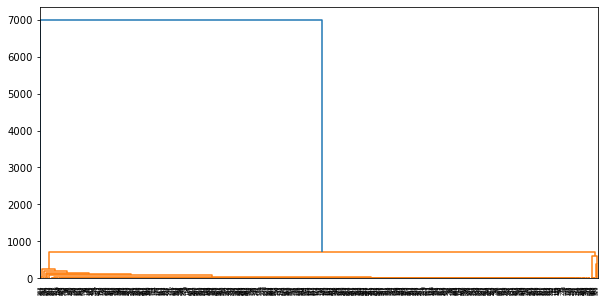

In [25]:
import scipy.cluster.hierarchy as sch

temp = df.copy(deep=True)
temp = temp[temp['room_type'] == 'Shared room']
temp.head()

plt.figure(1, figsize=(10, 5))
dendrogram = sch.dendrogram(sch.linkage(temp[['latitude', 'longitude', 'price']]))

plt.show()


m) briefly comment on what you observe from the structure of the dendrogram.  - (2.5 points)

-> your answer here

n) Normalize the `price` as in b) and repeat l) - (2.5 points)

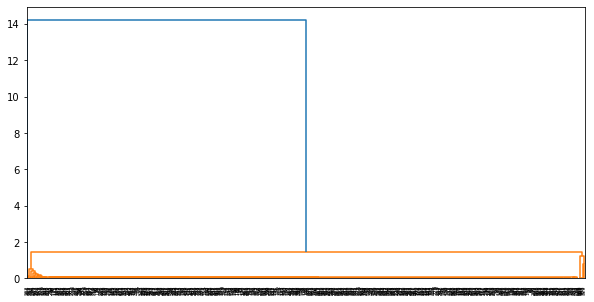

In [26]:
temp['price'] = temp['price'].subtract(temp['price'].mean()).divide(temp['price'].std())

plt.figure(1, figsize=(10, 5))
dendrogram = sch.dendrogram(sch.linkage(
    temp[['latitude', 'longitude', 'price']]))

plt.show()


## Exercise 2 (50 points)

This exercise will be using the [MNIST dataset](http://yann.lecun.com/exdb/mnist/).

a) Using Kmeans, cluster the images using 10 clusters and plot the centroid of each cluster. - (10 points)

(1797, 64)


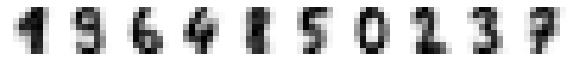

In [73]:
import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict
import numpy as np
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits

X, Y = load_digits(return_X_y=True)

kmeans = KMeans(n_clusters=10)
kmeans.fit(X)

centroids = kmeans.cluster_centers_
_, axes = plt.subplots(nrows=1, ncols=10, figsize=(10, 3))
for ax, image in zip(axes, centroids):
    ax.set_axis_off()
    image = image.reshape(8, 8)
    ax.imshow(image, cmap=plt.cm.gray_r, interpolation="nearest")


b) what is the disagreement distance between the clustering you created above and the clustering created by the labels attached to each image? Briefly explain what this number means in this context. - (10 points)

c) Download the CIFAR-10 dataset [here](https://www.cs.toronto.edu/~kriz/cifar.html). Open `batch_1` by following the documentation on the web page. Plot a random image from the dataset. - (10 points)

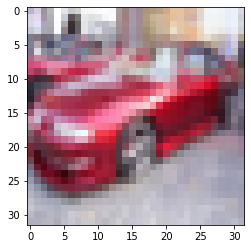

In [92]:
import random


def unpickle(file):
    import pickle
    with open(file, 'rb') as fo:
        dict = pickle.load(fo, encoding='latin1')
    return dict


data_batch_1 = unpickle('data_batch_1')

rand = random.randint(0, len(data_batch_1['data']))
image = data_batch_1['data'][rand]

image = image.reshape(3, 32, 32)
image = image.transpose(1, 2, 0)

plt.imshow(image)

d) This image is 32 x 32 pixels and each pixel is a 3-dimensional object of RGB (Red, Green, Blue) intensities. Using the same image as in c), produce an image that only uses 4 colors (the 4 centroids of the clusters obtained by clustering the image itself using Kmeans). - (10 points)

In [ ]:
kmeans = KMeans(n_clusters=4)
kmeans.fit(image.reshape(len(image), -1))


e) Write a function that applies this transformation to the entire dataset for any number K of colors. - (10 points)

In [ ]:
def compress(k = 4):
    pass
